In [81]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib.gridspec import GridSpec
from matplotlib.widgets import RangeSlider

1) Display Color Histograms for RGB Images

Objective: Calculate and display separate histograms for the R, G, and B channels of a color image.

Topics: Color histograms, channel separation.

Challenge: Compare histograms of different images (e.g., nature vs. synthetic images).

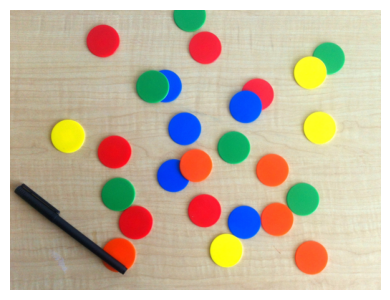

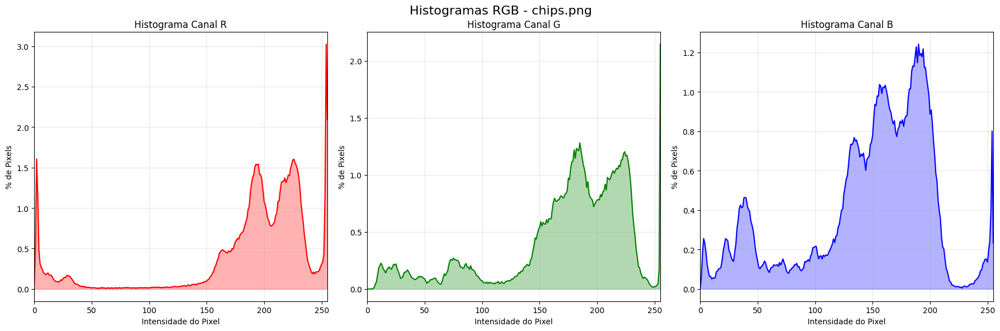

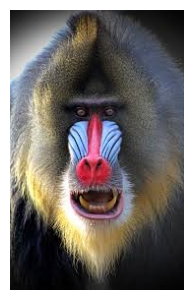

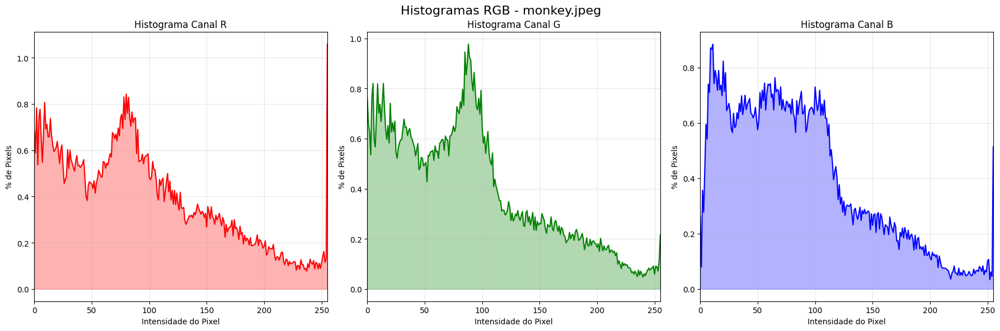

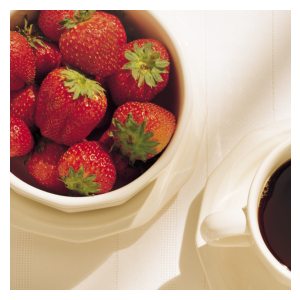

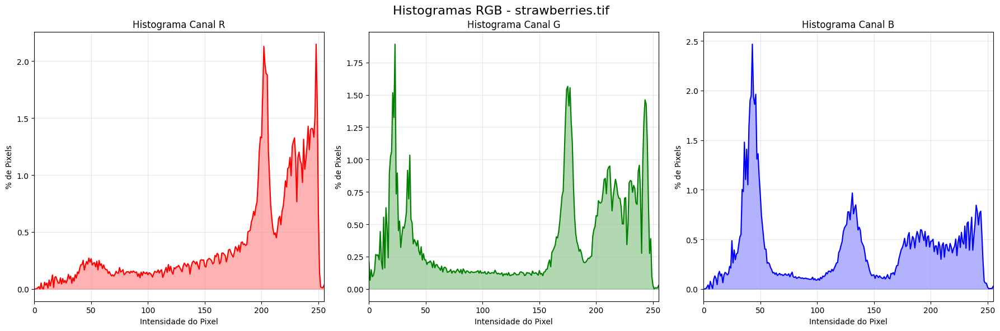

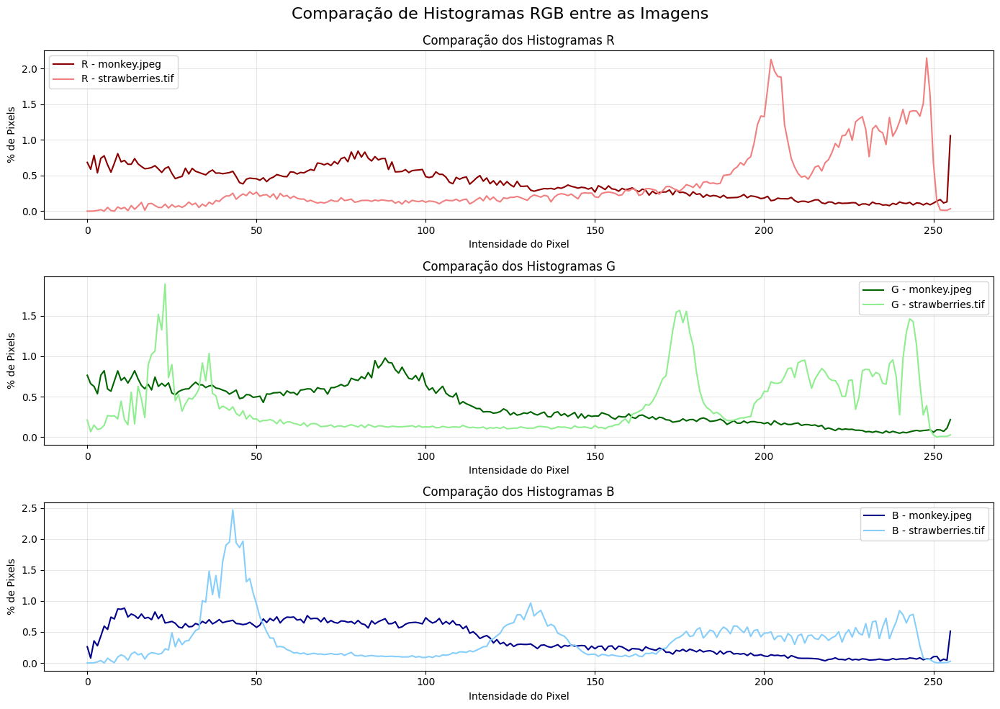


Similaridade entre os histogramas (correlação):
(1.0 = idênticos, -1.0 = inversos)

Canal R: -0.6869
Canal G: -0.3182
Canal B: -0.0525
Correlação média: -0.3525
As imagens têm distribuições de cores significativamente diferentes.


In [53]:
def plot_rgb_histograms(image, title="Histogramas RGB"):
    # Converter de BGR para RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Separar os canais R, G e B
    r, g, b = cv2.split(image_rgb)
    
    plt.figure(figsize=(14, 8))
    gs = GridSpec(2, 2)
    
    ax0 = plt.subplot(gs[1, :])
    ax0.imshow(image_rgb)
    ax0.axis('off')
    
    
    bins = 256
    hist_r = cv2.calcHist([r], [0], None, [bins], [0, 256])
    hist_g = cv2.calcHist([g], [0], None, [bins], [0, 256])
    hist_b = cv2.calcHist([b], [0], None, [bins], [0, 256])
    
    # Normalizar histogramas
    hist_r = hist_r / hist_r.sum() * 100
    hist_g = hist_g / hist_g.sum() * 100
    hist_b = hist_b / hist_b.sum() * 100
    
    fig,axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plotar histograma vermelho
    axes[0].plot(hist_r, color='red')
    axes[0].fill_between(range(bins), hist_r.flatten(), alpha=0.3, color='red')
    axes[0].set_title('Histograma Canal R')
    axes[0].set_xlim([0, bins-1])
    axes[0].set_xlabel('Intensidade do Pixel')
    axes[0].set_ylabel('% de Pixels')
    axes[0].grid(alpha=0.3)
    
    # Plotar histograma verde
    axes[1].plot(hist_g, color='green')
    axes[1].fill_between(range(bins), hist_g.flatten(), alpha=0.3, color='green')
    axes[1].set_title('Histograma Canal G')
    axes[1].set_xlim([0, bins-1])
    axes[1].set_xlabel('Intensidade do Pixel')
    axes[1].set_ylabel('% de Pixels')
    axes[1].grid(alpha=0.3)
    
    # Plotar histograma azul
    axes[2].plot(hist_b, color='blue')
    axes[2].fill_between(range(bins), hist_b.flatten(), alpha=0.3, color='blue')
    axes[2].set_title('Histograma Canal B')
    axes[2].set_xlim([0, bins-1])
    axes[2].set_xlabel('Intensidade do Pixel')
    axes[2].set_ylabel('% de Pixels')
    axes[2].grid(alpha=0.3)
    
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    
    return hist_r, hist_g, hist_b

def compare_image_histograms(image1, image2):
    
    img1 = cv2.imread(image1)
    img2 = cv2.imread(image2)
    
    if img1 is None or img2 is None:
        print("Erro ao carregar uma ou ambas as imagens!")
        return
    
    hist_r1, hist_g1, hist_b1 = plot_rgb_histograms(img1, f"Histogramas RGB - {os.path.basename(image1)}")
    plt.show()
    
    hist_r2, hist_g2, hist_b2 = plot_rgb_histograms(img2, f"Histogramas RGB - {os.path.basename(image2)}")
    plt.show()
    
    plt.figure(figsize=(14, 10))
    
    # Comparar histogramas R
    plt.subplot(3, 1, 1)
    plt.plot(hist_r1, color='darkred', label=f'R - {os.path.basename(image1)}')
    plt.plot(hist_r2, color='lightcoral', label=f'R - {os.path.basename(image2)}')
    plt.title('Comparação dos Histogramas R')
    plt.xlabel('Intensidade do Pixel')
    plt.ylabel('% de Pixels')
    plt.legend()
    plt.grid(alpha=0.3)
    
    # Comparar histogramas G
    plt.subplot(3, 1, 2)
    plt.plot(hist_g1, color='darkgreen', label=f'G - {os.path.basename(image1)}')
    plt.plot(hist_g2, color='lightgreen', label=f'G - {os.path.basename(image2)}')
    plt.title('Comparação dos Histogramas G')
    plt.xlabel('Intensidade do Pixel')
    plt.ylabel('% de Pixels')
    plt.legend()
    plt.grid(alpha=0.3)
    
    # Comparar histogramas B
    plt.subplot(3, 1, 3)
    plt.plot(hist_b1, color='darkblue', label=f'B - {os.path.basename(image1)}')
    plt.plot(hist_b2, color='lightskyblue', label=f'B - {os.path.basename(image2)}')
    plt.title('Comparação dos Histogramas B')
    plt.xlabel('Intensidade do Pixel')
    plt.ylabel('% de Pixels')
    plt.legend()
    plt.grid(alpha=0.3)
    
    plt.suptitle('Comparação de Histogramas RGB entre as Imagens', fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    # Calcular similaridade entre histogramas
    print("\nSimilaridade entre os histogramas (correlação):")
    print("(1.0 = idênticos, -1.0 = inversos)\n")
    r_correlation = cv2.compareHist(hist_r1, hist_r2, cv2.HISTCMP_CORREL)
    g_correlation = cv2.compareHist(hist_g1, hist_g2, cv2.HISTCMP_CORREL)
    b_correlation = cv2.compareHist(hist_b1, hist_b2, cv2.HISTCMP_CORREL)
    
    print(f"Canal R: {r_correlation:.4f}")
    print(f"Canal G: {g_correlation:.4f}")
    print(f"Canal B: {b_correlation:.4f}")
    
    # Correlação média
    avg_correlation = (r_correlation + g_correlation + b_correlation) / 3
    print(f"Correlação média: {avg_correlation:.4f}")
    
    if avg_correlation > 0.9:
        print("As imagens são muito similares em distribuição de cores.")
    elif avg_correlation > 0.7:
        print("As imagens têm distribuição de cores moderadamente similar.")
    elif avg_correlation > 0.4:
        print("As imagens têm alguma similaridade na distribuição de cores.")
    else:
        print("As imagens têm distribuições de cores significativamente diferentes.")

def process_single_image(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Erro ao carregar a imagem: {image_path}")
        return
    
    plot_rgb_histograms(img, f"Histogramas RGB - {os.path.basename(image_path)}")
    plt.show()

if __name__ == "__main__":
    
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/chips.png"
    process_single_image(image_path)
    
    image1 = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/monkey.jpeg"
    image2 = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/strawberries.tif"
    compare_image_histograms(image1, image2)

2) Visualize Individual Color Channels

Objective: Extract and display the Red, Green, and Blue channels of a color image as grayscale and pseudo-colored images.

Topics: Channel separation and visualization.

Bonus: Reconstruct the original image using the separated channels.


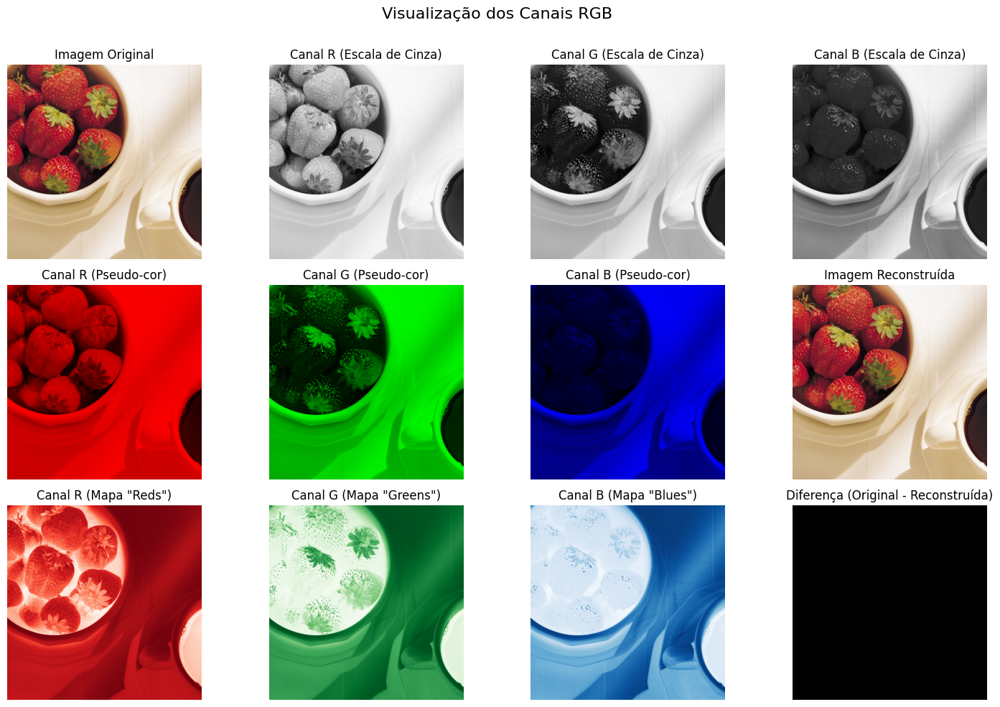

Estatísticas dos Canais:
Canal R - Min: 2, Max: 255, Média: 186.29
Canal G - Min: 0, Max: 255, Média: 145.85
Canal B - Min: 2, Max: 255, Média: 126.48

A reconstrução foi perfeita (imagens idênticas).


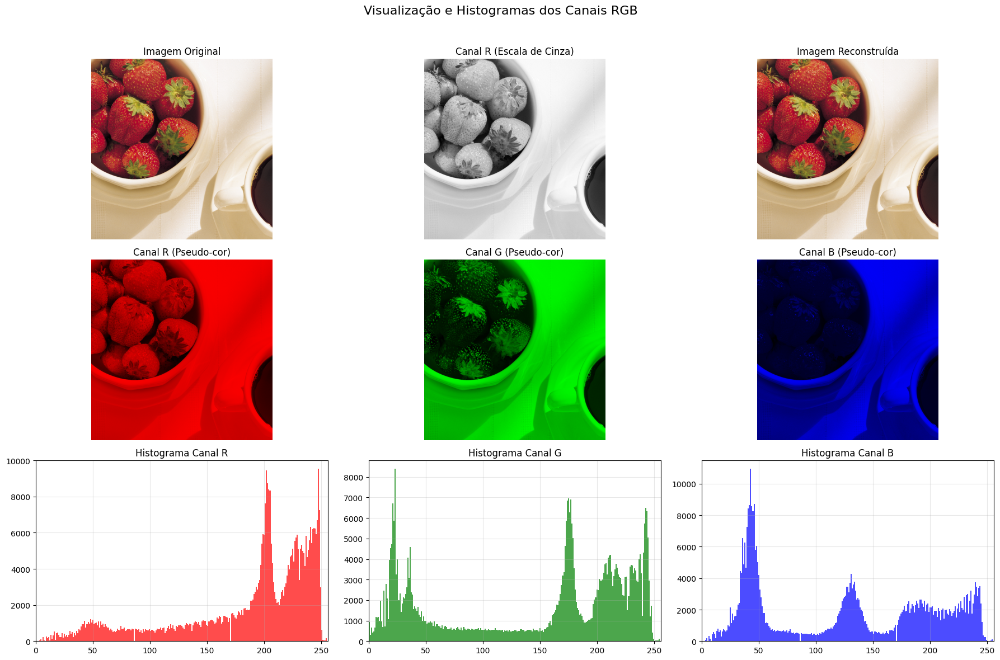

In [ ]:
def visualize_color_channels(image_path):
    
    image = cv2.imread(image_path)
    if image is None:
        print(f"Erro ao carregar a imagem: {image_path}")
        return
    
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    red_channel = image_rgb[:, :, 0]
    green_channel = image_rgb[:, :, 1]
    blue_channel = image_rgb[:, :, 2]
    
    # Canal vermelho pseudo-colorido
    red_colored = np.zeros_like(image_rgb)
    red_colored[:, :, 0] = red_channel
    
    # Canal verde pseudo-colorido
    green_colored = np.zeros_like(image_rgb)
    green_colored[:, :, 1] = green_channel
    
    # Canal azul pseudo-colorido
    blue_colored = np.zeros_like(image_rgb)
    blue_colored[:, :, 2] = blue_channel
    
    reconstructed_image = np.zeros_like(image_rgb)
    reconstructed_image[:, :, 0] = red_channel
    reconstructed_image[:, :, 1] = green_channel
    reconstructed_image[:, :, 2] = blue_channel
    
    difference = cv2.subtract(image_rgb, reconstructed_image)
    
    plt.figure(figsize=(15, 10))
    
    plt.subplot(3, 4, 1)
    plt.imshow(image_rgb)
    plt.title('Imagem Original')
    plt.axis('off')
    
    # Canal vermelho (escala de cinza)
    plt.subplot(3, 4, 2)
    plt.imshow(red_channel, cmap='gray')
    plt.title('Canal R (Escala de Cinza)')
    plt.axis('off')
    
    # Canal verde (escala de cinza)
    plt.subplot(3, 4, 3)
    plt.imshow(green_channel, cmap='gray')
    plt.title('Canal G (Escala de Cinza)')
    plt.axis('off')
    
    # Canal azul (escala de cinza)
    plt.subplot(3, 4, 4)
    plt.imshow(blue_channel, cmap='gray')
    plt.title('Canal B (Escala de Cinza)')
    plt.axis('off')
    
    # Canal vermelho (pseudo-colorido)
    plt.subplot(3, 4, 5)
    plt.imshow(red_colored)
    plt.title('Canal R (Pseudo-cor)')
    plt.axis('off')
    
    # Canal verde (pseudo-colorido)
    plt.subplot(3, 4, 6)
    plt.imshow(green_colored)
    plt.title('Canal G (Pseudo-cor)')
    plt.axis('off')
    
    # Canal azul (pseudo-colorido)
    plt.subplot(3, 4, 7)
    plt.imshow(blue_colored)
    plt.title('Canal B (Pseudo-cor)')
    plt.axis('off')
    
    # Visualizar canal vermelho com mapa de cores personalizado
    plt.subplot(3, 4, 9)
    plt.imshow(red_channel, cmap='Reds')
    plt.title('Canal R (Mapa "Reds")')
    plt.axis('off')
    
    # Visualizar canal verde com mapa de cores personalizado
    plt.subplot(3, 4, 10)
    plt.imshow(green_channel, cmap='Greens')
    plt.title('Canal G (Mapa "Greens")')
    plt.axis('off')
    
    # Visualizar canal azul com mapa de cores personalizado
    plt.subplot(3, 4, 11)
    plt.imshow(blue_channel, cmap='Blues')
    plt.title('Canal B (Mapa "Blues")')
    plt.axis('off')
    
    # Imagem reconstruída
    plt.subplot(3, 4, 8)
    plt.imshow(reconstructed_image)
    plt.title('Imagem Reconstruída')
    plt.axis('off')
    
    # Diferença entre original e reconstruída
    plt.subplot(3, 4, 12)
    plt.imshow(difference)
    plt.title('Diferença (Original - Reconstruída)')
    plt.axis('off')
    
    plt.suptitle('Visualização dos Canais RGB', fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    print("Estatísticas dos Canais:")
    print(f"Canal R - Min: {red_channel.min()}, Max: {red_channel.max()}, Média: {red_channel.mean():.2f}")
    print(f"Canal G - Min: {green_channel.min()}, Max: {green_channel.max()}, Média: {green_channel.mean():.2f}")
    print(f"Canal B - Min: {blue_channel.min()}, Max: {blue_channel.max()}, Média: {blue_channel.mean():.2f}")
    
    if np.array_equal(image_rgb, reconstructed_image):
        print("\nA reconstrução foi perfeita, as imagens são idênticas.")
    else:
        difference_sum = np.sum(difference)
        print(f"\nA reconstrução apresentou algumas diferenças (soma das diferenças = {difference_sum}).")

def visualize_channel_histograms(image_path):
    
    image = cv2.imread(image_path)
    if image is None:
        print(f"Erro ao carregar a imagem: {image_path}")
        return
    
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Extrair os canais
    red_channel = image_rgb[:, :, 0]
    green_channel = image_rgb[:, :, 1]
    blue_channel = image_rgb[:, :, 2]
    
    # Criar imagens pseudo-coloridas
    red_colored = np.zeros_like(image_rgb)
    red_colored[:, :, 0] = red_channel
    
    green_colored = np.zeros_like(image_rgb)
    green_colored[:, :, 1] = green_channel
    
    blue_colored = np.zeros_like(image_rgb)
    blue_colored[:, :, 2] = blue_channel
    
    # Configurar o layout da figura
    plt.figure(figsize=(18, 12))
    
    # Imagem original
    plt.subplot(3, 3, 1)
    plt.imshow(image_rgb)
    plt.title('Imagem Original')
    plt.axis('off')
    
    # Canal vermelho e seu histograma
    plt.subplot(3, 3, 4)
    plt.imshow(red_colored)
    plt.title('Canal R (Pseudo-cor)')
    plt.axis('off')
    
    plt.subplot(3, 3, 7)
    plt.hist(red_channel.ravel(), bins=256, color='red', alpha=0.7)
    plt.title('Histograma Canal R')
    plt.xlim([0, 256])
    plt.grid(alpha=0.3)
    
    # Canal verde e seu histograma
    plt.subplot(3, 3, 5)
    plt.imshow(green_colored)
    plt.title('Canal G (Pseudo-cor)')
    plt.axis('off')
    
    plt.subplot(3, 3, 8)
    plt.hist(green_channel.ravel(), bins=256, color='green', alpha=0.7)
    plt.title('Histograma Canal G')
    plt.xlim([0, 256])
    plt.grid(alpha=0.3)
    
    # Canal azul e seu histograma
    plt.subplot(3, 3, 6)
    plt.imshow(blue_colored)
    plt.title('Canal B (Pseudo-cor)')
    plt.axis('off')
    
    plt.subplot(3, 3, 9)
    plt.hist(blue_channel.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title('Histograma Canal B')
    plt.xlim([0, 256])
    plt.grid(alpha=0.3)
    
    # Canais em escala de cinza
    plt.subplot(3, 3, 2)
    plt.imshow(red_channel, cmap='gray')
    plt.title('Canal R (Escala de Cinza)')
    plt.axis('off')
    
    plt.subplot(3, 3, 3)
    plt.imshow(np.stack((red_channel, green_channel, blue_channel), axis=2))
    plt.title('Imagem Reconstruída')
    plt.axis('off')
    
    plt.suptitle('Visualização e Histogramas dos Canais RGB', fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


if __name__ == "__main__":
    # Substitua pelo caminho da sua imagem
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/strawberries.tif"
    
    # Visualização básica dos canais
    visualize_color_channels(image_path)
    
    # Visualização com histogramas
    visualize_channel_histograms(image_path)

3) Convert Between Color Spaces (RGB ↔ HSV, LAB, YCrCb, CMYK)

Objective: Convert an RGB image to other color spaces and display the result.

Topics: Color space conversion.

Challenge: Display individual channels from each converted space.

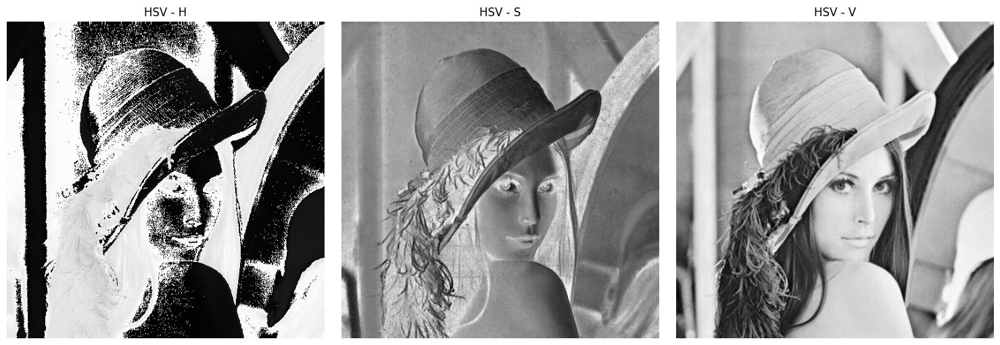

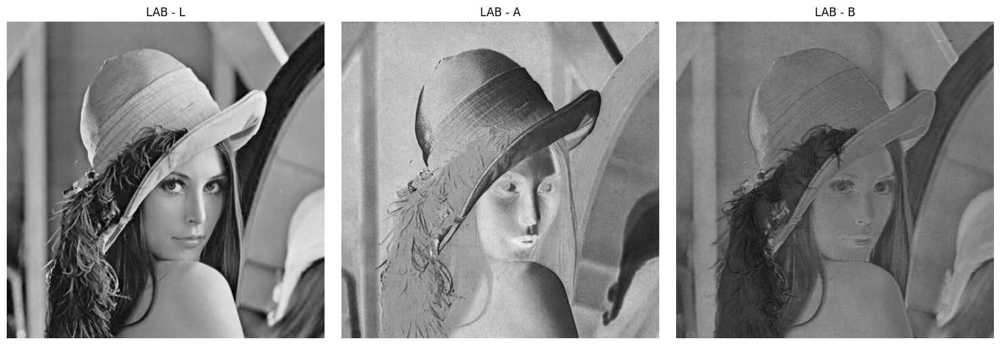

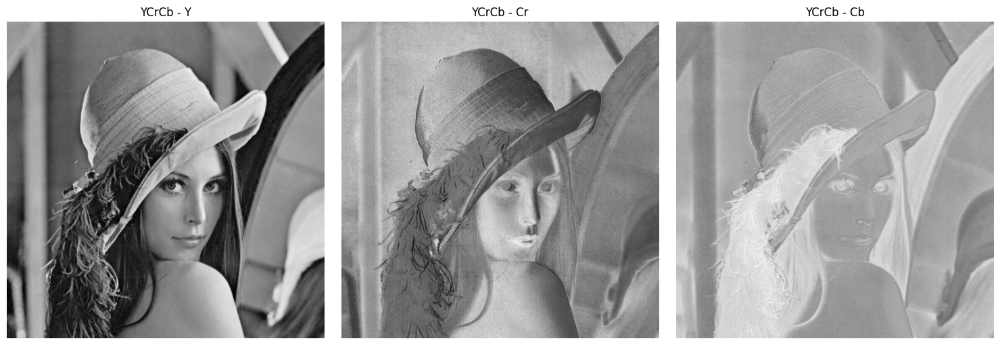

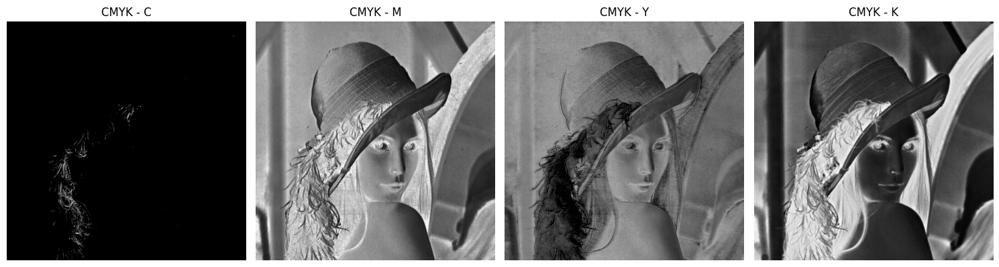

In [56]:
def show_channels(image, color_space_name, channel_names):
    channels = cv2.split(image)
    plt.figure(figsize=(15, 5))
    for i, (channel, name) in enumerate(zip(channels, channel_names)):
        plt.subplot(1, 3, i + 1)
        plt.imshow(channel, cmap='gray')
        plt.title(f'{color_space_name} - {name}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Carrega a imagem (substitua 'sua_imagem.jpg' pelo caminho da sua imagem)
img_bgr = cv2.imread('C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/lena.png')
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# HSV
img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
show_channels(img_hsv, "HSV", ["H", "S", "V"])

# LAB
img_lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
show_channels(img_lab, "LAB", ["L", "A", "B"])

# YCrCb
img_ycrcb = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)
show_channels(img_ycrcb, "YCrCb", ["Y", "Cr", "Cb"])

# CMYK (simulação)
img_float = img_rgb.astype(float) / 255
K = 1 - np.max(img_float, axis=2)
C = (1 - img_float[..., 0] - K) / (1 - K + 1e-6)
M = (1 - img_float[..., 1] - K) / (1 - K + 1e-6)
Y = (1 - img_float[..., 2] - K) / (1 - K + 1e-6)

# Normalizando para 8 bits
C = (C * 255).astype(np.uint8)
M = (M * 255).astype(np.uint8)
Y = (Y * 255).astype(np.uint8)
K = (K * 255).astype(np.uint8)

plt.figure(figsize=(15, 5))
for i, (channel, name) in enumerate(zip([C, M, Y, K], ["C", "M", "Y", "K"])):
    plt.subplot(1, 4, i + 1)
    plt.imshow(channel, cmap='gray')
    plt.title(f'CMYK - {name}')
    plt.axis('off')
plt.tight_layout()
plt.show()


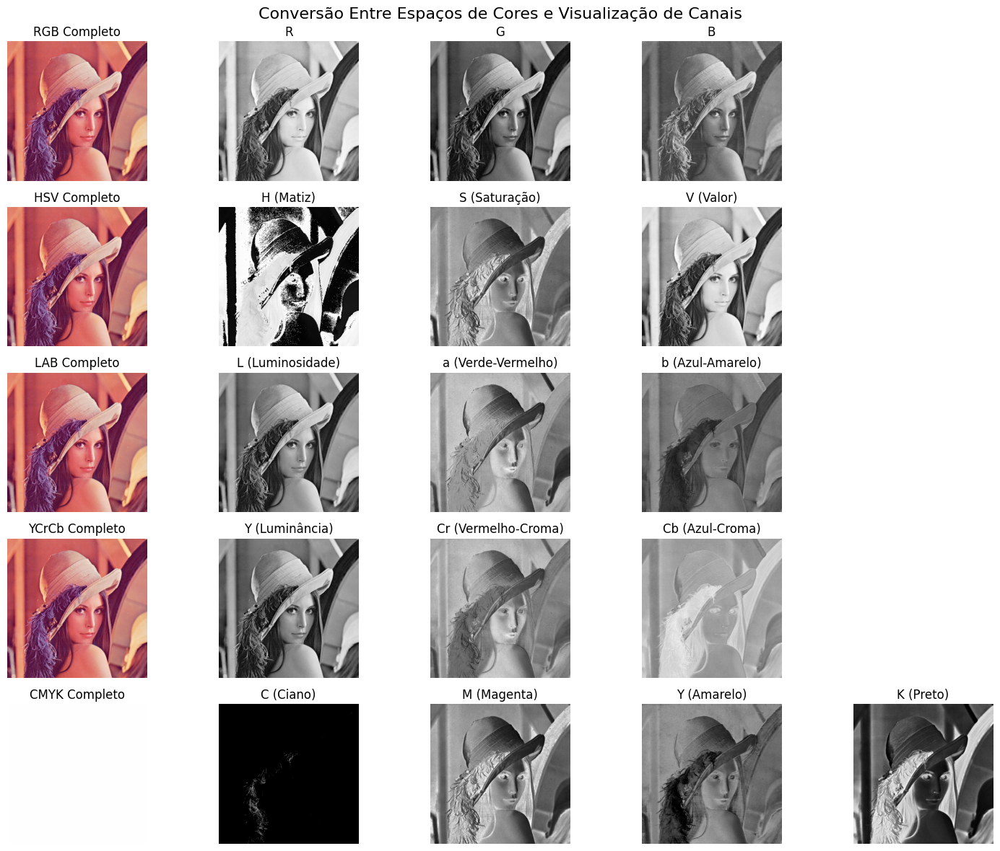

In [62]:
def convert_color_spaces(image_path):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Erro ao carregar a imagem: {image_path}")
        return
    
    # Converter de BGR (padrão OpenCV) para RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Converter para diferentes espaços de cores
    image_hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV)
    image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2LAB)
    image_ycrcb = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2YCrCb)
    
    image_rgb_norm = image_rgb.astype(np.float32) / 255.0
    
    # Converter para CMY
    image_cmy = 1 - image_rgb_norm
    
    k = np.min(image_cmy, axis=2)
    
    # Converter para CMYK
    image_cmyk = np.zeros((image_rgb.shape[0], image_rgb.shape[1], 4), dtype=np.float32)
    
    # Quando K=1, C=M=Y=0. Caso contrário, C=(C-K)/(1-K) e assim por diante
    for i in range(3):
        image_cmyk[:,:,i] = np.where(
            abs(1 - k) < 1e-10,
            0,
            (image_cmy[:,:,i] - k) / (1 - k)
        )
    
    image_cmyk[:,:,3] = k
    
    image_cmyk_scaled = (image_cmyk * 255).astype(np.uint8)
    
    plt.figure(figsize=(15, 12))
    
    color_spaces = [
        ('RGB', image_rgb, ['R', 'G', 'B']),
        ('HSV', image_hsv, ['H (Matiz)', 'S (Saturação)', 'V (Valor)']),
        ('LAB', image_lab, ['L (Luminosidade)', 'a (Verde-Vermelho)', 'b (Azul-Amarelo)']),
        ('YCrCb', image_ycrcb, ['Y (Luminância)', 'Cr (Vermelho-Croma)', 'Cb (Azul-Croma)']),
        ('CMYK', image_cmyk_scaled, ['C (Ciano)', 'M (Magenta)', 'Y (Amarelo)', 'K (Preto)'])
    ]
    
    for idx, (space_name, space_image, channel_names) in enumerate(color_spaces):
        plt.subplot(5, 5, idx*5 + 1)
        
        if space_name == 'RGB':
            plt.imshow(space_image)
        elif space_name == 'HSV':
            plt.imshow(cv2.cvtColor(space_image, cv2.COLOR_HSV2RGB))
        elif space_name == 'LAB':
            plt.imshow(cv2.cvtColor(space_image, cv2.COLOR_LAB2RGB))
        elif space_name == 'YCrCb':
            plt.imshow(cv2.cvtColor(space_image, cv2.COLOR_YCrCb2RGB))
        elif space_name == 'CMYK':
            cmyk_preview = np.zeros_like(image_rgb)
            cmyk_preview[:,:,0] = 255 - space_image[:,:,0] * (255 - space_image[:,:,3]) / 255
            cmyk_preview[:,:,1] = 255 - space_image[:,:,1] * (255 - space_image[:,:,3]) / 255
            cmyk_preview[:,:,2] = 255 - space_image[:,:,2] * (255 - space_image[:,:,3]) / 255
            plt.imshow(cmyk_preview)
        
        plt.title(f'{space_name} Completo')
        plt.axis('off')
    
        for i, channel_name in enumerate(channel_names):
            plt.subplot(5, 5, idx*5 + i + 2)
            
            plt.imshow(space_image[:,:,i], cmap='gray')
            plt.title(f'{channel_name}')
            plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle('Conversão Entre Espaços de Cores e Visualização de Canais', fontsize=16)
    plt.subplots_adjust(top=0.94)
    plt.show()

# Executar a função
if __name__ == "__main__":
    # Substitua pelo caminho da sua imagem
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/lena.png"
    
    # Converter e exibir espaços de cores
    convert_color_spaces(image_path)

4) Compare Effects of Blurring in RGB vs HSV

Objective: Apply Gaussian blur in both RGB and HSV color spaces and compare results.

Topics: Color space effect on filtering.

Discussion: Why HSV might preserve color better in some operations.

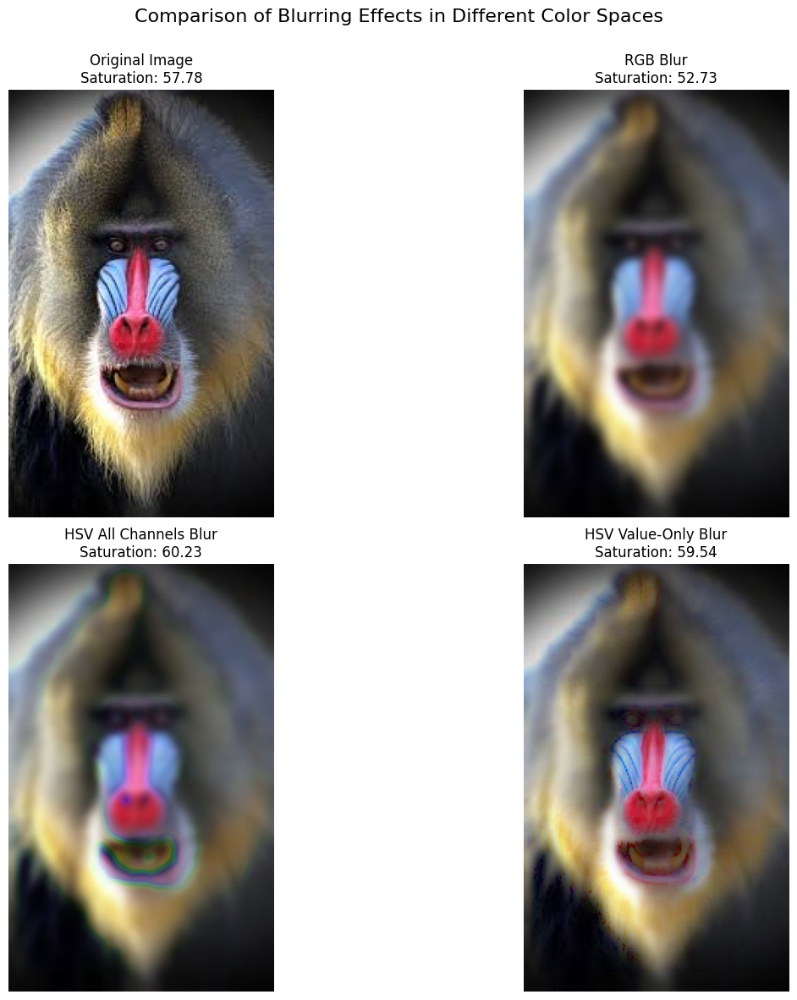

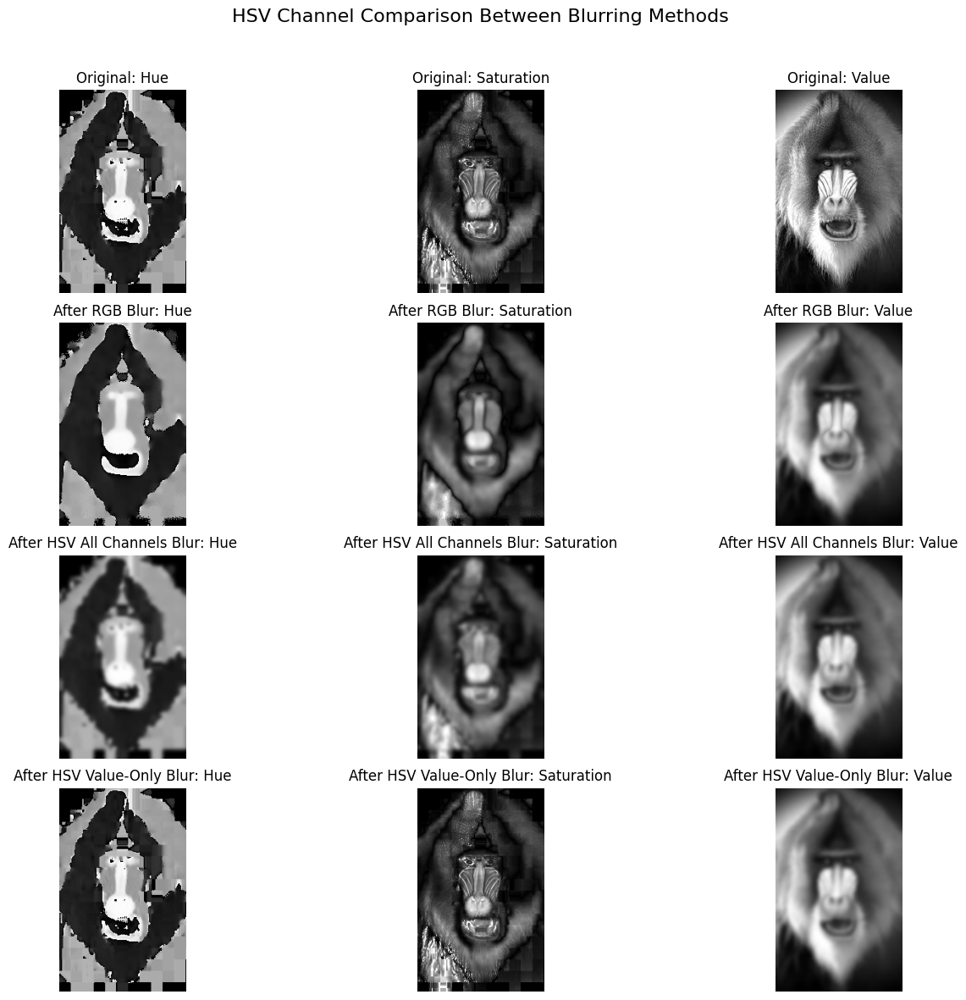

In [ ]:
def compare_blur(image_path, blur_size=15):
    
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Could not load image from {image_path}")
    
    
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    rgb_blurred = cv2.GaussianBlur(img_rgb, (blur_size, blur_size), 0)
    
    
    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    
    hsv_all_blurred = cv2.GaussianBlur(img_hsv, (blur_size, blur_size), 0)
    hsv_all_blurred_rgb = cv2.cvtColor(hsv_all_blurred, cv2.COLOR_HSV2RGB)
    
    hsv_v_only = img_hsv.copy()
    hsv_v_only[:,:,2] = cv2.GaussianBlur(hsv_v_only[:,:,2], (blur_size, blur_size), 0)
    hsv_v_blurred_rgb = cv2.cvtColor(hsv_v_only, cv2.COLOR_HSV2RGB)
    
    
    def calculate_saturation(image):
        
        if len(image.shape) == 3 and image.shape[2] == 3:
            if np.array_equal(image, img_hsv):
                hsv_img = image
            else:
                hsv_img = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            return np.mean(hsv_img[:,:,1])
        return None
    
    orig_saturation = calculate_saturation(img_rgb)
    rgb_blur_saturation = calculate_saturation(rgb_blurred)
    hsv_all_saturation = calculate_saturation(hsv_all_blurred_rgb)
    hsv_v_saturation = calculate_saturation(hsv_v_blurred_rgb)
    
    plt.figure(figsize=(15, 12))
    
    images = [
        (img_rgb, "Original Image", f"Saturation: {orig_saturation:.2f}"),
        (rgb_blurred, "RGB Blur", f"Saturation: {rgb_blur_saturation:.2f}"),
        (hsv_all_blurred_rgb, "HSV All Channels Blur", f"Saturation: {hsv_all_saturation:.2f}"),
        (hsv_v_blurred_rgb, "HSV Value-Only Blur", f"Saturation: {hsv_v_saturation:.2f}")
    ]
    
    
    for i, (img, title, sat_text) in enumerate(images):
        plt.subplot(2, 2, i+1)
        plt.imshow(img)
        plt.title(f"{title}\n{sat_text}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("comparison of blur effect in RGB vs HSV", fontsize=16)
    plt.subplots_adjust(top=0.9)
    
    plt.figure(figsize=(15, 12))
    
    hsv_original = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    hsv_rgb_blurred = cv2.cvtColor(rgb_blurred, cv2.COLOR_RGB2HSV)
    
    hsv_images = [
        (hsv_original, "Original"),
        (hsv_rgb_blurred, "After RGB Blur"),
        (hsv_all_blurred, "After HSV All Channels Blur"),
        (hsv_v_only, "After HSV Value-Only Blur")
    ]
    
    channel_names = ["Hue", "Saturation", "Value"]
    
    for i, (hsv_img, title) in enumerate(hsv_images):
        for j, channel_name in enumerate(channel_names):
            plt.subplot(4, 3, i*3 + j + 1)
            plt.imshow(hsv_img[:,:,j], cmap='gray')
            plt.title(f"{title}: {channel_name}")
            plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("HSV Channel Comparison Between Blurring Methods", fontsize=16)
    plt.subplots_adjust(top=0.9)
    
    plt.show()
    
    return img_rgb, rgb_blurred, hsv_all_blurred_rgb, hsv_v_blurred_rgb

if __name__ == "__main__":
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/monkey.jpeg"
    compare_blur(image_path, blur_size=15)

5) Apply Edge Detection Filters (Sobel, Laplacian) on Color Images

Objective: Apply Sobel and Laplacian filters on individual channels and on the grayscale version of the image.

Topics: Edge detection, spatial filtering.

Bonus: Merge edge maps from all channels to form a combined result.

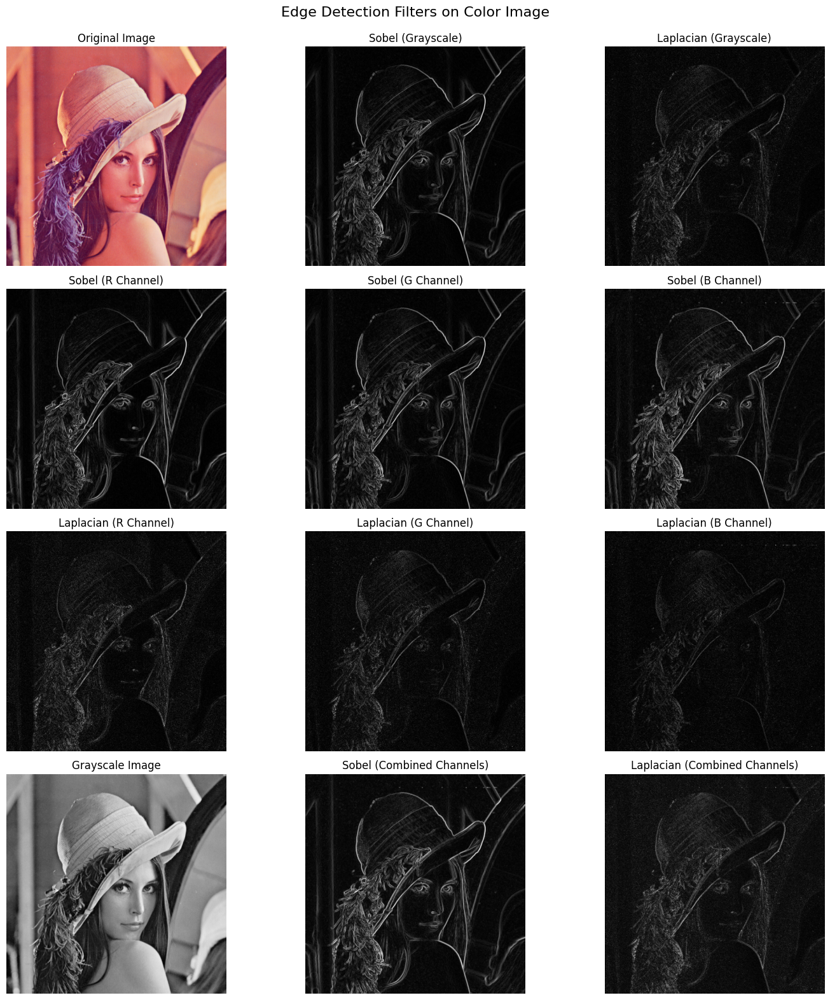

In [ ]:
def edge_detection(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image: {image_path}")
        return
    
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    
    sobel_x_gray = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y_gray = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=3)
    sobel_gray = np.sqrt(sobel_x_gray**2 + sobel_y_gray**2)
    sobel_gray = cv2.normalize(sobel_gray, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    

    laplacian_gray = cv2.Laplacian(img_gray, cv2.CV_64F)
    laplacian_gray = np.abs(laplacian_gray)
    laplacian_gray = cv2.normalize(laplacian_gray, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    
    sobel_r = np.zeros_like(img_gray)
    sobel_g = np.zeros_like(img_gray)
    sobel_b = np.zeros_like(img_gray)
    
    for i, channel in enumerate(['R', 'G', 'B']):
        sobel_x = cv2.Sobel(img_rgb[:,:,i], cv2.CV_64F, 1, 0, ksize=3)
        sobel_y = cv2.Sobel(img_rgb[:,:,i], cv2.CV_64F, 0, 1, ksize=3)
        
    
        sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)
        sobel_mag = cv2.normalize(sobel_mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        
        if i == 0:
            sobel_r = sobel_mag
        elif i == 1:
            sobel_g = sobel_mag
        else:
            sobel_b = sobel_mag
    
    laplacian_r = np.abs(cv2.Laplacian(img_rgb[:,:,0], cv2.CV_64F))
    laplacian_g = np.abs(cv2.Laplacian(img_rgb[:,:,1], cv2.CV_64F))
    laplacian_b = np.abs(cv2.Laplacian(img_rgb[:,:,2], cv2.CV_64F))
    
    laplacian_r = cv2.normalize(laplacian_r, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    laplacian_g = cv2.normalize(laplacian_g, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    laplacian_b = cv2.normalize(laplacian_b, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    
    sobel_combined = np.maximum.reduce([sobel_r, sobel_g, sobel_b])
    laplacian_combined = np.maximum.reduce([laplacian_r, laplacian_g, laplacian_b])
    
    fig, axes = plt.subplots(4, 3, figsize=(15, 16))
    
    # Original image
    axes[0, 0].imshow(img_rgb)
    axes[0, 0].set_title('Original Image')
    axes[0, 0].axis('off')
    
    # Sobel on grayscale
    axes[0, 1].imshow(sobel_gray, cmap='gray')
    axes[0, 1].set_title('Sobel (Grayscale)')
    axes[0, 1].axis('off')
    
    # Laplacian on grayscale
    axes[0, 2].imshow(laplacian_gray, cmap='gray')
    axes[0, 2].set_title('Laplacian (Grayscale)')
    axes[0, 2].axis('off')
    
    # Sobel on R, G, B channels
    axes[1, 0].imshow(sobel_r, cmap='gray')
    axes[1, 0].set_title('Sobel (R Channel)')
    axes[1, 0].axis('off')
    
    axes[1, 1].imshow(sobel_g, cmap='gray')
    axes[1, 1].set_title('Sobel (G Channel)')
    axes[1, 1].axis('off')
    
    axes[1, 2].imshow(sobel_b, cmap='gray')
    axes[1, 2].set_title('Sobel (B Channel)')
    axes[1, 2].axis('off')
    
    # Laplacian on R, G, B channels
    axes[2, 0].imshow(laplacian_r, cmap='gray')
    axes[2, 0].set_title('Laplacian (R Channel)')
    axes[2, 0].axis('off')
    
    axes[2, 1].imshow(laplacian_g, cmap='gray')
    axes[2, 1].set_title('Laplacian (G Channel)')
    axes[2, 1].axis('off')
    
    axes[2, 2].imshow(laplacian_b, cmap='gray')
    axes[2, 2].set_title('Laplacian (B Channel)')
    axes[2, 2].axis('off')
    
    # Combined results
    axes[3, 0].imshow(img_gray, cmap='gray')
    axes[3, 0].set_title('Grayscale Image')
    axes[3, 0].axis('off')
    
    axes[3, 1].imshow(sobel_combined, cmap='gray')
    axes[3, 1].set_title('Sobel (Combined Channels)')
    axes[3, 1].axis('off')
    
    axes[3, 2].imshow(laplacian_combined, cmap='gray')
    axes[3, 2].set_title('Laplacian (Combined Channels)')
    axes[3, 2].axis('off')
    
    plt.tight_layout()
    plt.suptitle('Edge Detection Filters on Color Image', fontsize=16)
    plt.subplots_adjust(top=0.94)
    plt.show()

if __name__ == "__main__":
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/lena.png"
    edge_detection(image_path)

6) High-pass and Low-pass Filtering in the Frequency Domain

Objective: Perform DFT on each channel of a color image, apply high-pass and low-pass masks, then reconstruct the image.

Topics: Frequency domain filtering, Fourier Transform.

Tools: cv2.dft(), cv2.idft(), numpy.fft.

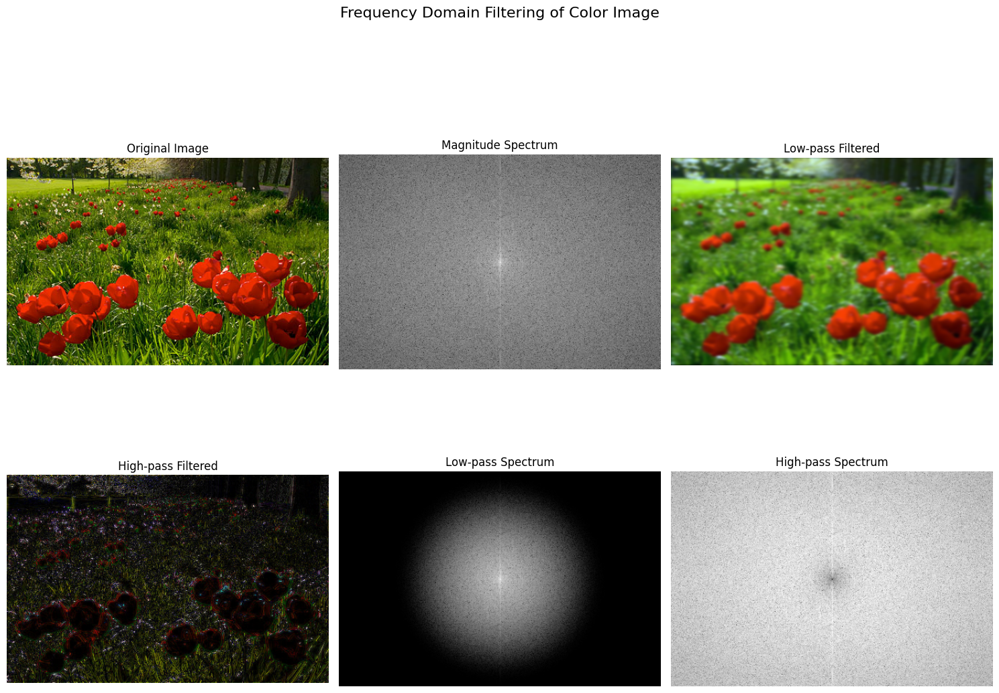

In [ ]:
def highpass_lowpass_filtering(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image: {image_path}")
        return
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    
    rows, cols, channels = img_rgb.shape
    highpass_img = np.zeros_like(img_rgb, dtype=np.float32)
    lowpass_img = np.zeros_like(img_rgb, dtype=np.float32)
    
    for c in range(channels):
        
        channel = img_rgb[:,:,c].astype(np.float32)
        
        optimal_rows = cv2.getOptimalDFTSize(rows)
        optimal_cols = cv2.getOptimalDFTSize(cols)
        padded = cv2.copyMakeBorder(channel, 0, optimal_rows - rows, 0, optimal_cols - cols, 
                                    cv2.BORDER_CONSTANT, value=0)
        
        dft = cv2.dft(padded, flags=cv2.DFT_COMPLEX_OUTPUT)
        dft_shift = np.fft.fftshift(dft) 
       
        crow, ccol = optimal_rows // 2, optimal_cols // 2
        
       
        radius = 30 
        low_pass_mask = np.zeros((optimal_rows, optimal_cols, 2), np.float32)
        
        
        x = np.arange(optimal_cols) - ccol
        y = np.arange(optimal_rows) - crow
        X, Y = np.meshgrid(x, y)
        D = np.sqrt(X**2 + Y**2)
        
        # Gaussian low-pass filter
        low_pass_mask[:,:,0] = np.exp(-(D**2) / (2 * radius**2))
        low_pass_mask[:,:,1] = np.exp(-(D**2) / (2 * radius**2))
        
        high_pass_mask = 1 - low_pass_mask
        
        
        low_pass_result = cv2.mulSpectrums(dft_shift, low_pass_mask, 0)
        high_pass_result = cv2.mulSpectrums(dft_shift, high_pass_mask, 0)
        
        
        low_pass_shift = np.fft.ifftshift(low_pass_result)
        high_pass_shift = np.fft.ifftshift(high_pass_result)
        
        low_pass_ishift = cv2.idft(low_pass_shift)
        high_pass_ishift = cv2.idft(high_pass_shift)
        
        
        low_pass_channel = cv2.magnitude(low_pass_ishift[:,:,0], low_pass_ishift[:,:,1])
        high_pass_channel = cv2.magnitude(high_pass_ishift[:,:,0], high_pass_ishift[:,:,1])
        
        
        cv2.normalize(low_pass_channel, low_pass_channel, 0, 255, cv2.NORM_MINMAX)
        cv2.normalize(high_pass_channel, high_pass_channel, 0, 255, cv2.NORM_MINMAX)
        
        
        low_pass_channel = low_pass_channel[0:rows, 0:cols]
        high_pass_channel = high_pass_channel[0:rows, 0:cols]
        
        
        lowpass_img[:,:,c] = low_pass_channel
        highpass_img[:,:,c] = high_pass_channel
        
       
        magnitude_spectrum = 20 * np.log(cv2.magnitude(dft_shift[:,:,0], dft_shift[:,:,1]) + 1)
        low_pass_spectrum = 20 * np.log(cv2.magnitude(low_pass_result[:,:,0], low_pass_result[:,:,1]) + 1) 
        high_pass_spectrum = 20 * np.log(cv2.magnitude(high_pass_result[:,:,0], high_pass_result[:,:,1]) + 1)
    
   
    lowpass_img = np.clip(lowpass_img, 0, 255).astype(np.uint8)
    highpass_img = np.clip(highpass_img, 0, 255).astype(np.uint8)
    
    
    plt.figure(figsize=(15, 12))
    
    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    # Magnitude spectrum 
    plt.subplot(2, 3, 2)
    plt.imshow(magnitude_spectrum, cmap='gray')
    plt.title('Magnitude Spectrum')
    plt.axis('off')
    
    # Low-pass filtered image
    plt.subplot(2, 3, 3)
    plt.imshow(lowpass_img)
    plt.title('Low-pass Filtered')
    plt.axis('off')
    
    # Low-pass spectrum
    plt.subplot(2, 3, 5)
    plt.imshow(low_pass_spectrum, cmap='gray')
    plt.title('Low-pass Spectrum')
    plt.axis('off')
    
    # High-pass filtered image
    plt.subplot(2, 3, 4)
    plt.imshow(highpass_img)
    plt.title('High-pass Filtered')
    plt.axis('off')
    
    # High-pass spectrum
    plt.subplot(2, 3, 6)
    plt.imshow(high_pass_spectrum, cmap='gray')
    plt.title('High-pass Spectrum')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle('Frequency Domain Filtering of Color Image', fontsize=16)
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    return img_rgb, lowpass_img, highpass_img

if __name__ == "__main__":
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/flowers.jpg"
    highpass_lowpass_filtering(image_path)

7) Visualize and Manipulate Bit Planes of Color Images

Objective: Extract bit planes (especially MSB and LSB) from each color channel and display them.

Topics: Bit slicing, data visualization.

Challenge: Reconstruct the image using only the top 4 bits of each channel.


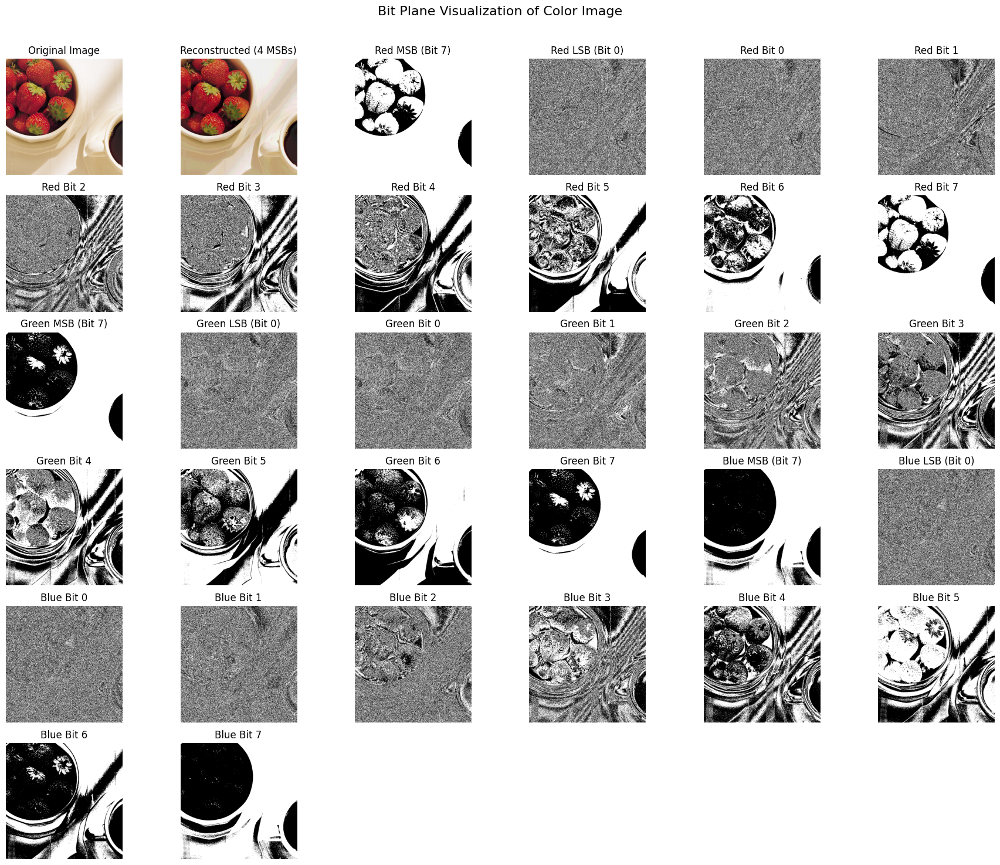

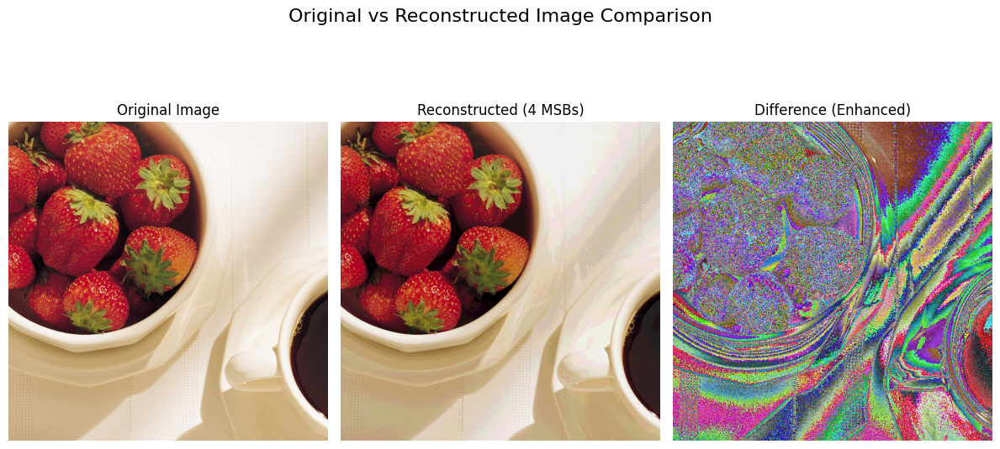

In [80]:
def bit_planes(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image: {image_path}")
        return
    
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    height, width, channels = img_rgb.shape

    
    bit_planes = np.zeros((8, 3, height, width), dtype=np.uint8)
    
    for c in range(channels):
        for bit in range(8):
            bit_planes[bit, c] = np.right_shift(img_rgb[:,:,c], bit) & 1
            
            
            bit_planes[bit, c] = bit_planes[bit, c] * 255
    
    
    reconstructed_img = np.zeros_like(img_rgb)
    
    for c in range(channels):
        for bit in range(4, 8): 
            bit_value = np.left_shift(bit_planes[bit, c] // 255, bit)
            reconstructed_img[:,:,c] = reconstructed_img[:,:,c] + bit_value
    

    channel_names = ['Red', 'Green', 'Blue']
    
    
    plt.figure(figsize=(18, 15))
    
    plt.subplot(6, 6, 1)
    plt.imshow(img_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(6, 6, 2)
    plt.imshow(reconstructed_img)
    plt.title('Reconstructed (4 MSBs)')
    plt.axis('off')
    
    plot_index = 3
    for c in range(channels):
        # MSB
        plt.subplot(6, 6, plot_index)
        plt.imshow(bit_planes[7, c], cmap='gray')
        plt.title(f'{channel_names[c]} MSB (Bit 7)')
        plt.axis('off')
        plot_index += 1
        
        # LSB
        plt.subplot(6, 6, plot_index)
        plt.imshow(bit_planes[0, c], cmap='gray')
        plt.title(f'{channel_names[c]} LSB (Bit 0)')
        plt.axis('off')
        plot_index += 1
        
        # Display all bit planes for this channel
        for bit in range(8):
            plt.subplot(6, 6, plot_index)
            plt.imshow(bit_planes[bit, c], cmap='gray')
            plt.title(f'{channel_names[c]} Bit {bit}')
            plt.axis('off')
            plot_index += 1
    
    plt.tight_layout()
    plt.suptitle('Bit Plane Visualization of Color Image', fontsize=16)
    plt.subplots_adjust(top=0.92)
    
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 3, 1)
    plt.imshow(img_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(reconstructed_img)
    plt.title('Reconstructed (4 MSBs)')
    plt.axis('off')
    
    diff_img = cv2.absdiff(img_rgb, reconstructed_img)

    diff_img = cv2.normalize(diff_img, None, 0, 255, cv2.NORM_MINMAX)
    
    plt.subplot(1, 3, 3)
    plt.imshow(diff_img)
    plt.title('Difference (Enhanced)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle('Original vs Reconstructed Image Comparison', fontsize=16)
    plt.subplots_adjust(top=0.85)
    
    plt.show()
    
    return img_rgb, reconstructed_img, bit_planes

if __name__ == "__main__":
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/strawberries.tif"
    bit_planes(image_path)

8) Color-based Object Segmentation using HSV Thresholding

Objective: Convert image to HSV, apply thresholding to extract objects of a certain color (e.g., red apples).

Topics: Color segmentation, HSV masking.

Bonus: Use trackbars to adjust thresholds dynamically.

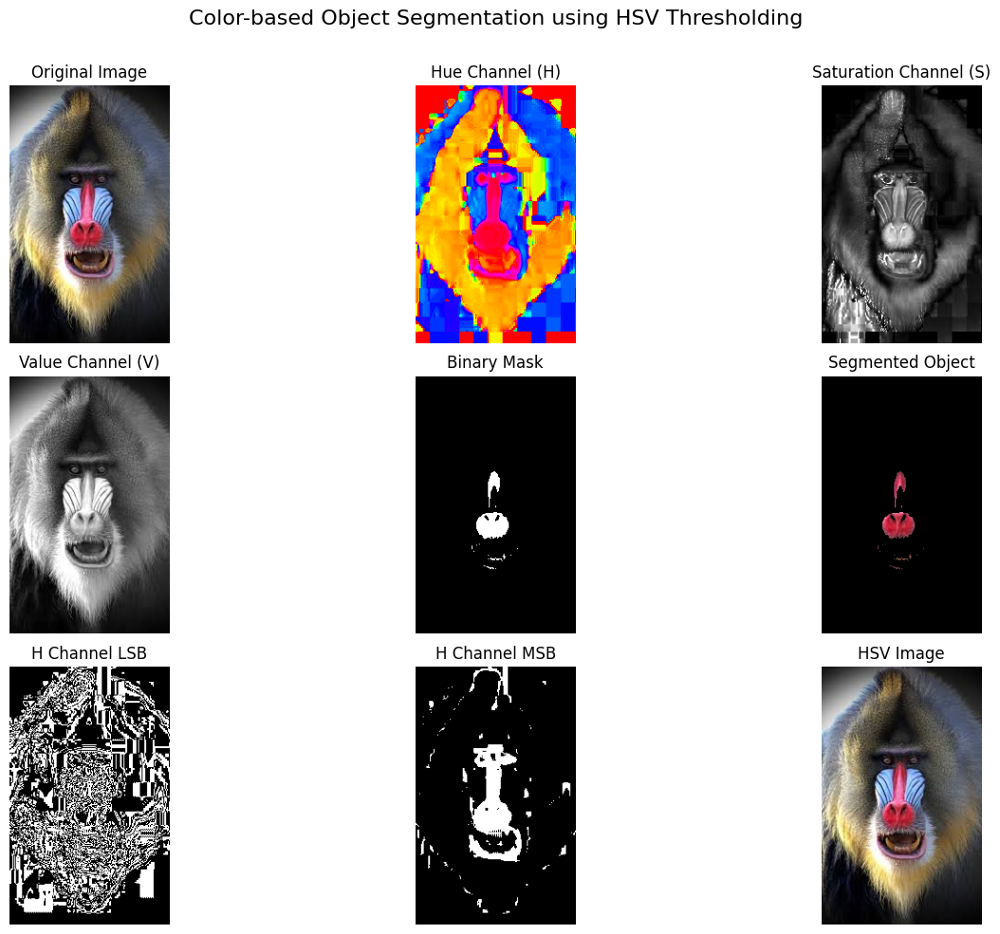

In [84]:
def segmentation_hsv(image_path, lower_hsv=(0, 100, 100), upper_hsv=(10, 255, 255)):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image: {image_path}")
        return
    
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
   
    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)

    lower_bound = np.array(lower_hsv)
    upper_bound = np.array(upper_hsv)
    
  
    mask = cv2.inRange(img_hsv, lower_bound, upper_bound)
    
    if lower_hsv[0] < 10: 
        lower_red2 = np.array([170, lower_hsv[1], lower_hsv[2]])
        upper_red2 = np.array([180, upper_hsv[1], upper_hsv[2]])
        mask2 = cv2.inRange(img_hsv, lower_red2, upper_red2)
        mask = cv2.bitwise_or(mask, mask2)
        
    segmented = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
    
    h, s, v = cv2.split(img_hsv)
    
   
    plt.figure(figsize=(15, 10))
    
    plt.subplot(3, 3, 1)
    plt.imshow(img_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
   
    plt.subplot(3, 3, 2)
    plt.imshow(h, cmap='hsv')
    plt.title('Hue Channel (H)')
    plt.axis('off')
    
    plt.subplot(3, 3, 3)
    plt.imshow(s, cmap='gray')
    plt.title('Saturation Channel (S)')
    plt.axis('off')
    
    plt.subplot(3, 3, 4)
    plt.imshow(v, cmap='gray')
    plt.title('Value Channel (V)')
    plt.axis('off')
    
   
    plt.subplot(3, 3, 5)
    plt.imshow(mask, cmap='gray')
    plt.title('Binary Mask')
    plt.axis('off')
    
 
    plt.subplot(3, 3, 6)
    plt.imshow(segmented)
    plt.title('Segmented Object')
    plt.axis('off')
    
    
    plt.subplot(3, 3, 7)
    plt.imshow(h & 1, cmap='gray')
    plt.title('H Channel LSB')
    plt.axis('off')
    
    plt.subplot(3, 3, 8)
    plt.imshow(np.right_shift(h, 7) & 1, cmap='gray')
    plt.title('H Channel MSB')
    plt.axis('off')
    

    plt.subplot(3, 3, 9)
    plt.imshow(cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB))
    plt.title('HSV Image')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle('Color-based Object Segmentation using HSV Thresholding', fontsize=16)
    plt.subplots_adjust(top=0.9)
    plt.show()

if __name__ == "__main__":
    image_path = "C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/monkey.jpeg"
    
    segmentation_hsv(image_path)

9) Convert and Visualize Images in the NTSC (YIQ) Color Space

Objective: Manually convert an RGB image to NTSC (YIQ) and visualize the Y, I, and Q channels.

Topics: Color space math, visualization.

Note: OpenCV doesn’t support YIQ directly, so students can implement the conversion using matrices.

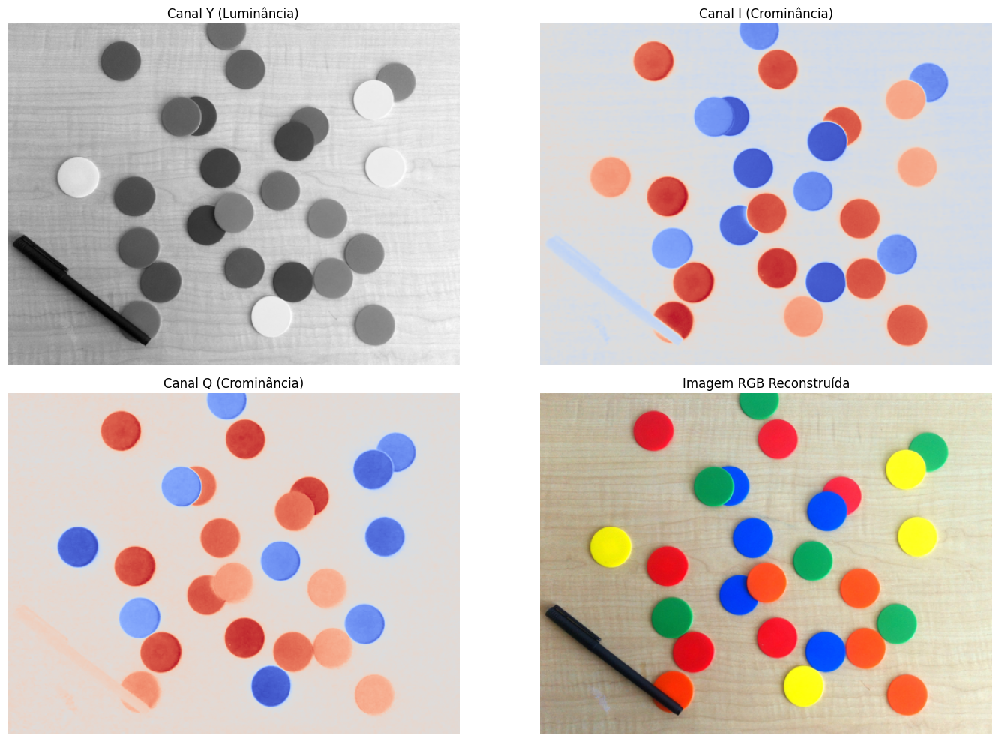

In [86]:
def rgb_to_yiq(image):
  
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    rgb_norm = rgb_image.astype(np.float32) / 255.0
    
    conversion_matrix = np.array([
        [0.299, 0.587, 0.114],
        [0.596, -0.274, -0.322],
        [0.211, -0.523, 0.312]
    ])
    
    height, width, _ = rgb_norm.shape
    rgb_reshaped = rgb_norm.reshape(-1, 3).T
    
    yiq_reshaped = np.dot(conversion_matrix, rgb_reshaped)
    
    yiq_image = yiq_reshaped.T.reshape(height, width, 3)
    
    return yiq_image

def visualize_channels(yiq_image):
    y_channel = yiq_image[:, :, 0]
    i_channel = yiq_image[:, :, 1]
    q_channel = yiq_image[:, :, 2]
    
    i_channel_normalized = i_channel + 0.5
    q_channel_normalized = q_channel + 0.5
    
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.imshow(y_channel, cmap='gray')
    plt.title('Canal Y (Luminância)')
    plt.axis('off')
    
    # Canal I (crominância)
    plt.subplot(2, 2, 2)
    plt.imshow(i_channel_normalized, cmap='coolwarm')
    plt.title('Canal I (Crominância)')
    plt.axis('off')
    
    # Canal Q (crominância)
    plt.subplot(2, 2, 3)
    plt.imshow(q_channel_normalized, cmap='coolwarm')
    plt.title('Canal Q (Crominância)')
    plt.axis('off')
    
    plt.subplot(2, 2, 4)
    yiq_to_rgb = yiq_to_rgb_conversion(yiq_image)
    plt.imshow(yiq_to_rgb)
    plt.title('Imagem RGB Reconstruída')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

def yiq_to_rgb_conversion(yiq_image):
  
    inverse_matrix = np.array([
        [1.0, 0.956, 0.621],
        [1.0, -0.272, -0.647],
        [1.0, -1.106, 1.703]
    ])
    
    height, width, _ = yiq_image.shape
    yiq_reshaped = yiq_image.reshape(-1, 3).T
    rgb_reshaped = np.dot(inverse_matrix, yiq_reshaped)
    rgb_image = rgb_reshaped.T.reshape(height, width, 3)
    rgb_image = np.clip(rgb_image, 0, 1)
    
    return rgb_image

image_path = 'C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/chips.png'
image = cv2.imread(image_path)

if image is None:
    print(f"Erro ao carregar a imagem: {image_path}")
else:
    yiq_image = rgb_to_yiq(image)
    
    visualize_channels(yiq_image)


10) Color Image Enhancement with Histogram Equalization

Objective: Apply histogram equalization on individual channels in different color spaces (e.g., Y in YCrCb, L in LAB).

Topics: Contrast enhancement, color models.

Discussion: Explain why histogram equalization should not be directly applied to RGB.

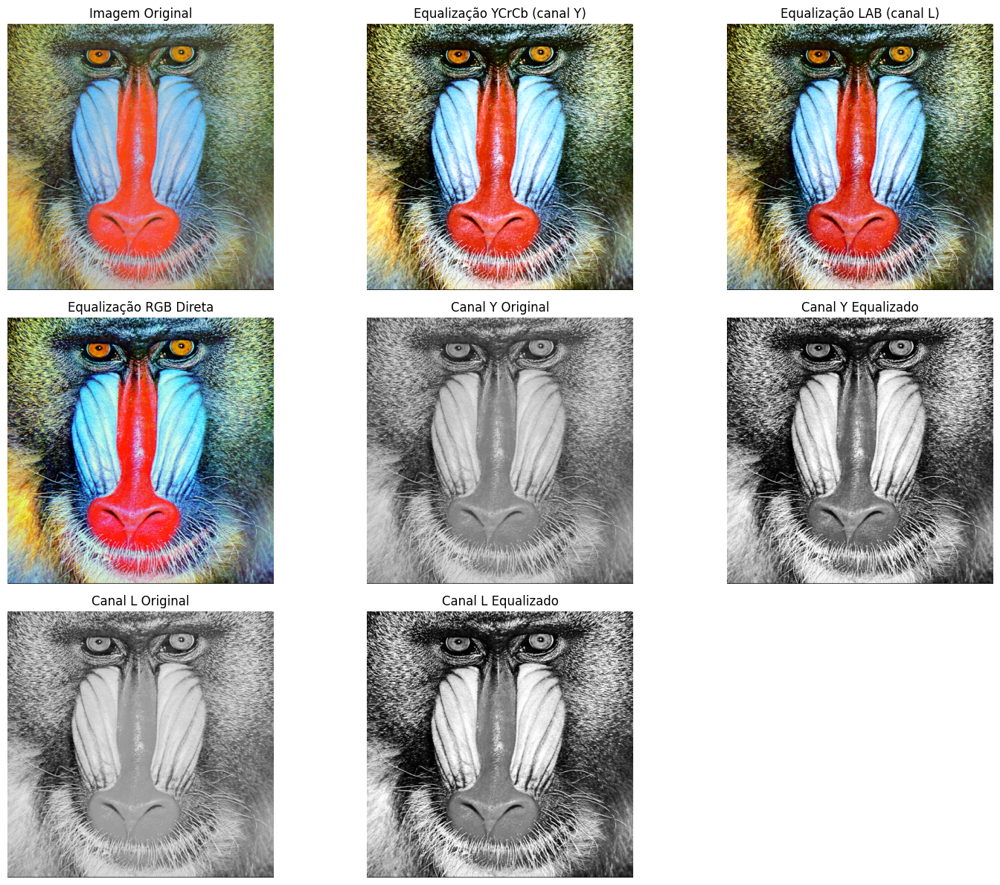

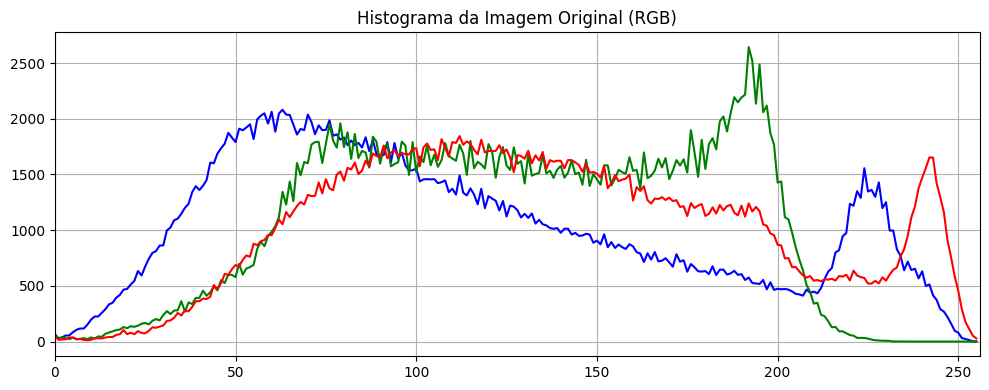

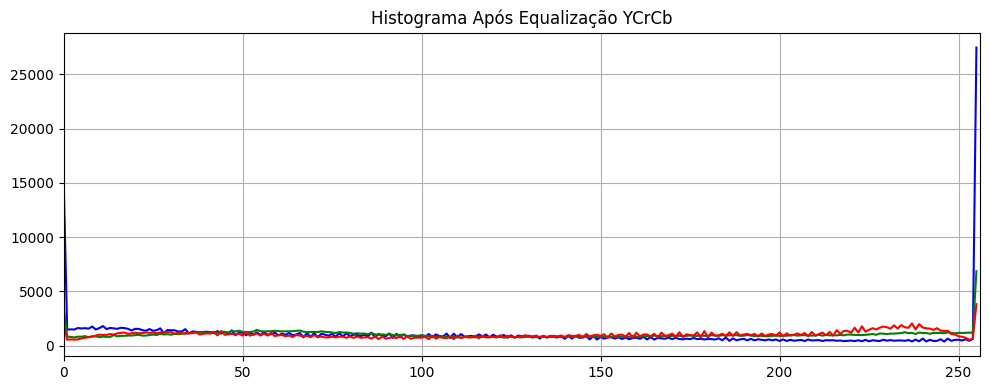

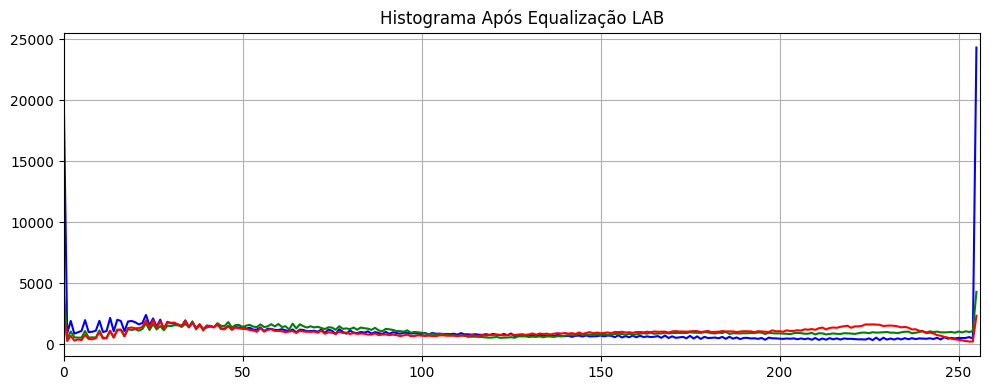

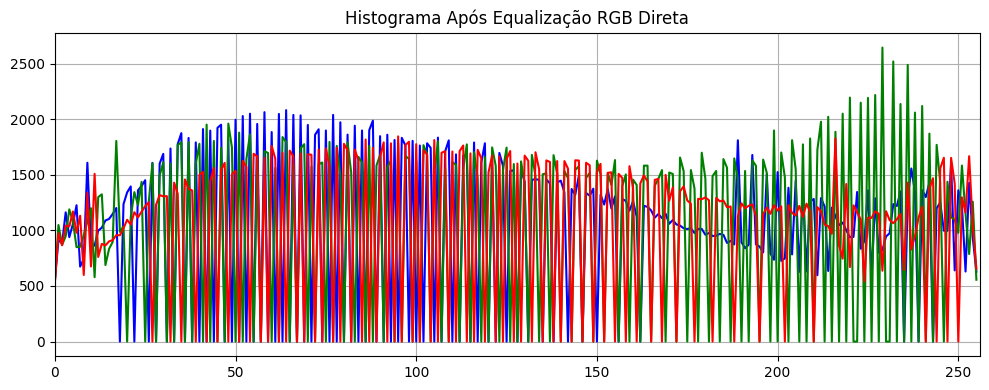

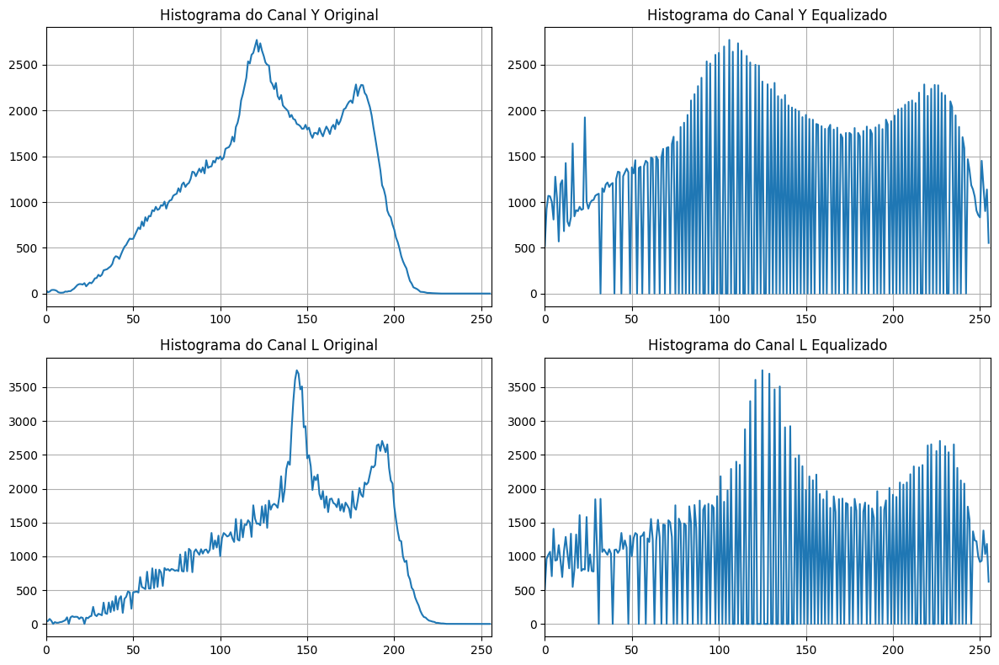

In [88]:
def plot_histogram(image, title):
    if len(image.shape) == 3:  
        colors = ('b', 'g', 'r')
        plt.figure(figsize=(10, 4))
        for i, color in enumerate(colors):
            hist = cv2.calcHist([image], [i], None, [256], [0, 256])
            plt.plot(hist, color=color)
        plt.xlim([0, 256])
    else: 
        plt.figure(figsize=(10, 4))
        hist = cv2.calcHist([image], [0], None, [256], [0, 256])
        plt.plot(hist)
        plt.xlim([0, 256])
    
    plt.title(title)
    plt.grid(True)
    plt.tight_layout()

def enhance_ycrcb(image):
   
    ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    y, cr, cb = cv2.split(ycrcb)
    y_eq = cv2.equalizeHist(y)
    ycrcb_eq = cv2.merge([y_eq, cr, cb])
    enhanced = cv2.cvtColor(ycrcb_eq, cv2.COLOR_YCrCb2BGR)
    
    return enhanced, y, y_eq

def enhance_lab(image):
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l_eq = cv2.equalizeHist(l)
    lab_eq = cv2.merge([l_eq, a, b])
    enhanced = cv2.cvtColor(lab_eq, cv2.COLOR_LAB2BGR)
    
    return enhanced, l, l_eq

def enhance_rgb_direct(image):
    b, g, r = cv2.split(image)
    
    b_eq = cv2.equalizeHist(b)
    g_eq = cv2.equalizeHist(g)
    r_eq = cv2.equalizeHist(r)
    
    enhanced = cv2.merge([b_eq, g_eq, r_eq])
    
    return enhanced

def compare_methods(image_path):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Erro ao carregar a imagem: {image_path}")
        return
    
    ycrcb_enhanced, y, y_eq = enhance_ycrcb(image)
    lab_enhanced, l, l_eq = enhance_lab(image)
    rgb_direct_enhanced = enhance_rgb_direct(image)
    
    plt.figure(figsize=(15, 12))
    
    # Imagem original
    plt.subplot(3, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Imagem Original')
    plt.axis('off')
    
    # Realce YCrCb
    plt.subplot(3, 3, 2)
    plt.imshow(cv2.cvtColor(ycrcb_enhanced, cv2.COLOR_BGR2RGB))
    plt.title('Equalização YCrCb (canal Y)')
    plt.axis('off')
    
    # Realce LAB
    plt.subplot(3, 3, 3)
    plt.imshow(cv2.cvtColor(lab_enhanced, cv2.COLOR_BGR2RGB))
    plt.title('Equalização LAB (canal L)')
    plt.axis('off')
    
    # Realce RGB direto
    plt.subplot(3, 3, 4)
    plt.imshow(cv2.cvtColor(rgb_direct_enhanced, cv2.COLOR_BGR2RGB))
    plt.title('Equalização RGB Direta')
    plt.axis('off')
    
    # Canal Y antes e depois
    plt.subplot(3, 3, 5)
    plt.imshow(y, cmap='gray')
    plt.title('Canal Y Original')
    plt.axis('off')
    
    plt.subplot(3, 3, 6)
    plt.imshow(y_eq, cmap='gray')
    plt.title('Canal Y Equalizado')
    plt.axis('off')
    
    # Canal L antes e depois
    plt.subplot(3, 3, 7)
    plt.imshow(l, cmap='gray')
    plt.title('Canal L Original')
    plt.axis('off')
    
    plt.subplot(3, 3, 8)
    plt.imshow(l_eq, cmap='gray')
    plt.title('Canal L Equalizado')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    plot_histogram(image, 'Histograma da Imagem Original (RGB)')
    plt.show()
    
    plot_histogram(ycrcb_enhanced, 'Histograma Após Equalização YCrCb')
    plt.show()
    
    plot_histogram(lab_enhanced, 'Histograma Após Equalização LAB')
    plt.show()
    
    plot_histogram(rgb_direct_enhanced, 'Histograma Após Equalização RGB Direta')
    plt.show()
    
    plt.figure(figsize=(12, 8))
    
    plt.subplot(2, 2, 1)
    hist_y = cv2.calcHist([y], [0], None, [256], [0, 256])
    plt.plot(hist_y)
    plt.title('Histograma do Canal Y Original')
    plt.xlim([0, 256])
    plt.grid(True)
    
    plt.subplot(2, 2, 2)
    hist_y_eq = cv2.calcHist([y_eq], [0], None, [256], [0, 256])
    plt.plot(hist_y_eq)
    plt.title('Histograma do Canal Y Equalizado')
    plt.xlim([0, 256])
    plt.grid(True)
    
    plt.subplot(2, 2, 3)
    hist_l = cv2.calcHist([l], [0], None, [256], [0, 256])
    plt.plot(hist_l)
    plt.title('Histograma do Canal L Original')
    plt.xlim([0, 256])
    plt.grid(True)
    
    plt.subplot(2, 2, 4)
    hist_l_eq = cv2.calcHist([l_eq], [0], None, [256], [0, 256])
    plt.plot(hist_l_eq)
    plt.title('Histograma do Canal L Equalizado')
    plt.xlim([0, 256])
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

image_path = 'C:/Users/mathe/Documents/UFAL/2024.2/PDI/dip-2024-2/img/baboon.png' 
compare_methods(image_path)


A equalização de histograma não deve ser aplicada diretamente aos canais RGB, pois isso pode comprometer a qualidade visual da imagem. Isso ocorre porque os canais R, G e B são fortemente correlacionados entre si, e a equalização independente de cada um deles altera o equilíbrio entre as cores, resultando em tons artificiais ou distorcidos. Além disso, o modelo RGB não separa informações de cor e brilho, então qualquer modificação em um canal afeta tanto a luminância quanto a crominância. Esse tipo de processamento também pode amplificar ruídos presentes em cada canal, gerando artefatos visuais como manchas coloridas. Em contrapartida, espaços de cor como YCrCb e LAB separam a informação de brilho (Y ou L) das informações de cor (Cr/Cb ou a/b), permitindo que a equalização seja aplicada apenas no canal de luminância. Dessa forma, é possível melhorar o contraste da imagem sem comprometer a fidelidade das cores originais.